# Diplomatura en Ciencia de Datos, Aprendizaje Automático y sus Aplicaciones

## Aprendizaje Supervisado

### Competencia de Kaggle: _Predicción de diabetes_

Grupo 30:

- Camino, Fernando
- Herrador, Emanuel Nicolás
- Rapoport, Juana
- Stutz, Sebastián
- Szurlewicz, Juan Ignacio

---


## Índice


- [1. Introducción](#1-introducción)
- [2. Desarrollo previo](#2-desarrollo-previo)
  - [2.1. Importación de librerías](#21-importación-de-librerías)
  - [2.2. Carga de datos](#22-carga-de-datos)
- [3. Descripción de los datos](#3-descripción-de-los-datos)
- [4. Análisis descriptivo de los datos](#4-análisis-descriptivo-de-los-datos)
  - [4.1. Análisis de feature vs. target (diabetes)](#41-análisis-de-feature-vs-target-diabetes)
  - [4.2. Análisis de 2 features vs. target (diabetes)](#42-análisis-de-2-features-vs-target-diabetes)
  - [4.3. Análisis de correlación](#43-análisis-de-correlación)
- [5. Preprocesamiento de los datos](#5-preprocesamiento-de-datos)
  - [5.1. Consideración de valores nulos en `gender` y `smoking_status`](#51-consideración-de-valores-nulos-en-gender-y-smoking_status)
  - [5.2. Reducción de categorías en `smoking_status`](#52-reducción-de-categorías-en-smoking_status)
  - [5.3. Eliminación de _features_ no relevantes](#53-eliminación-de-features-no-relevantes)
  - [5.4. División entre features y target](#54-división-entre-features-y-target)
  - [5.5. Encoding de variables categóricas](#55-encoding-de-variables-categóricas)
  - [5.6. Imputación de valores nulos](#56-imputación-de-valores-nulos)
  - [5.7. Escalado de variables](#57-escalado-de-variables)
  - [5.8. Balanceo de clases](#58-balanceo-de-clases)
- [6. Predicción de diabetes (Modelado)](#6-predicción-de-diabetes-modelado)
  - [6.1. Funciones auxiliares](#61-funciones-auxiliares)
  - [6.2. Predicción con dataset con _features_ relevantes](#62-predicción-con-dataset-con-features-relevantes)
    - [6.2.1. Modelos de clasificación con hiperparámetros por defecto](#621-modelos-de-clasificación-con-hipérparámetros-por-defecto)
    - [6.2.2. Modelos de clasificación con hiperparámetros optimizados](#622-modelos-de-clasificación-con-hiperparámetros-optimizados)
    - [6.2.3. Conclusiones](#623-conclusiones)
  - [6.3. Predicción con dataset sin balancear](#63-predicción-con-dataset-sin-balancear)
    - [6.3.1. Modelos de clasificación con hiperparámetros por defecto](#631-modelos-de-clasificación-con-hipérparámetros-por-defecto)
    - [6.3.2. Modelos de clasificación con hiperparámetros optimizados](#632-modelos-de-clasificación-con-hiperparámetros-optimizados)
    - [6.3.3. Conclusiones](#633-conclusiones)
  - [6.4. Predicción con dataset balanceado](#64-predicción-con-dataset-balanceado)
    - [6.4.1. Modelos de clasificación con hiperparámetros por defecto](#641-modelos-de-clasificación-con-hipérparámetros-por-defecto)
    - [6.4.2. Modelos de clasificación con hiperparámetros optimizados](#642-modelos-de-clasificación-con-hiperparámetros-optimizados)
    - [6.4.3. Conclusiones](#643-conclusiones)
- [7. Idea de mejora](#7-idea-de-mejora)
  - [7.1. Modelos de clasificación con hiperparámetros por defecto](#71-modelos-de-clasificación-con-hipérparámetros-por-defecto)
  - [7.2. Modelos de clasificación con hiperparámetros optimizados](#72-modelos-de-clasificación-con-hiperparámetros-optimizados)
  - [7.3. Conclusiones](#73-conclusiones)
- [8. Conclusiones finales](#8-conclusiones-finales)


## 1. Introducción


El presente trabajo consiste en la explicación y desarrollo de los modelos utilizados para la predicción de la diabetes para la competencia de Kaggle que se brindó como trabajo práctico de la materia. La idea del presente entregable es explicar cuál fue nuestro análisis a los datos brindados para entrenamiento y cuáles fueron los mejores modelos que encontramos para predecir la diabetes en base a estos datos vs. su verdadera performance en el dataset de testeo (el puntaje privado de la competencia).

Además, consideraremos dos enfoques a lo largo de este trabajo:

- Mejorar la _accuracy_ general
- Mejorar la _balanced_accuracy_

Si bien la competencia menciona que se usa _balanced_accuracy_ como métrica de evaluación, hemos notado que, en realidad, no la usa, sino que hace uso directamente de la _accuracy_ (por eso se notó un bajo "rendimiento" de los modelos que balancean mejor la predicción sobre los que no, aunque debió haber sido al revés).

Otro punto a destacar es que, dado que este trabajo es de la materia de _Aprendizaje Supervisado_, los modelos y las técnicas utilizadas para la predicción de la diabetes se basarán únicamente en el aprendizaje supervisado. Por ejemplo, no se utilizará PCA para la reducción de componentes principales, aunque durante la competencia hayamos notado que es una técnica muy útil para mejorar la performance y la eficiencia de los modelos.

Además, y como nota final, se destaca que en el presente trabajo se prefirió dejar cómo se realizó la búsqueda de hiperparámetros y demás análisis (no todos los realizados durante la competencia, obviamente), para desarrollar mucho más cómo se obtuvo cada modelo y cómo se llegó a la conclusión de que es el mejor para predecir la diabetes.


## 2. Desarrollo previo


### 2.1. Importación de librerías


Las librerías que vamos a usar en el presente proyecto son las siguientes:


In [1]:
# Importamos las librerías
import pandas as pd
import numpy as np

# Visualización
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px

# Transformación de los datos
from sklearn.preprocessing import RobustScaler, LabelEncoder
from sklearn.impute import SimpleImputer
from imblearn.under_sampling import InstanceHardnessThreshold

# Evaluación de modelos
from sklearn.model_selection import (
    StratifiedKFold,
    cross_validate,
    GridSearchCV,
)

# Modelos
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import LinearSVC
from sklearn.tree import DecisionTreeClassifier, ExtraTreeClassifier
from sklearn.linear_model import (
    LogisticRegression,
    RidgeClassifier,
    SGDClassifier,
    PassiveAggressiveClassifier,
)
from sklearn.ensemble import (
    ExtraTreesClassifier,
    RandomForestClassifier,
    GradientBoostingClassifier,
    HistGradientBoostingClassifier
)
from xgboost import XGBClassifier

# Seteamos la seed para reproducibilidad
random_seed = 0
np.random.seed(random_seed)

### 2.2. Carga de datos


Realizamos la carga de los datos que vamos a utilizar en el proyecto para el entrenamiento y para nuestra predicción:


In [2]:
TRAIN_DATA = pd.read_csv('data/diabetes_prediction_dataset_train-labeled.csv')
TEST_DATA = pd.read_csv('data/diabetes_prediction_dataset_test.csv')

# Age es tipo int
TRAIN_DATA['age'] = TRAIN_DATA['age'].astype(int)
TEST_DATA['age'] = TEST_DATA['age'].astype(int)

# Sacamos el id del dataset de entrenamiento
TRAIN_DATA.drop('patient', axis=1, inplace=True)

# Mostramos las primeras filas del dataset
display(TRAIN_DATA.head())
display(TEST_DATA.head())

,gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level,diabetes
0,Male,4,0,0,never,19.28,3.5,155,0
1,Female,50,0,0,former,27.32,5.7,159,0
2,Female,43,0,0,never,21.54,4.5,145,0
3,Male,64,0,0,current,28.22,6.0,130,0
4,Male,10,0,0,No Info,15.46,6.1,140,0


,patient,gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level,diabetes
0,49267,Male,53,0,0,never,31.99,4.5,126,NaN
1,82280,Female,22,0,0,never,25.96,6.6,130,NaN
2,33216,Female,37,0,0,never,22.24,6.2,126,NaN
3,94551,Female,29,0,0,not current,31.01,5.0,80,NaN
4,43760,Male,30,0,0,ever,28.66,6.6,100,NaN


## 3. Descripción de los datos


Esta competencia ha sido creada a partir de un dataset sobre una recopilación de datos médicos y demográficos de los pacientes, junto con su estado de diabetes (positivo o negativo).

Los datos incluyen características como la edad, el sexo, el índice de masa corporal (IMC), la hipertensión, las enfermedades cardíacas, el historial de tabaquismo, el nivel de HbA1c y el nivel de glucosa en sangre:

- `Gender`: Género se refiere al sexo biológico del individuo, que puede tener un impacto en su susceptibilidad a la diabetes. Hay tres categorías en él masculino, femenino y otro.
- `Age`: La edad es un factor importante ya que la diabetes se diagnostica con mayor frecuencia en adultos mayores. El rango de edad en el conjunto de datos es de 0 a 80.
- `Hypertension`: La hipertensión es una afección médica en la que la presión arterial en las arterias está persistentemente elevada. Tiene valores de 0 o 1 donde 0 indica que no tienen hipertensión y para 1 significa que tienen hipertensión.
- `Heart Disease`: La enfermedad cardíaca es otra afección médica que se asocia con un mayor riesgo de desarrollar diabetes. Tiene valores de 0 o 1 donde 0 indica que no tienen enfermedad cardíaca y para 1 significa que tienen enfermedad cardíaca.
- `Smoking History`: La historia de tabaquismo también se considera un factor de riesgo para la diabetes y puede exacerbar las complicaciones asociadas con la diabetes. En nuestro conjunto de datos tenemos 5 categorías es decir, not current, former, No Info, current, never y ever.
- `bmi`: BMI (Índice de Masa Corporal) es una medida de la grasa corporal basada en el peso y la altura. Los valores de BMI más altos están vinculados a un mayor riesgo de diabetes. El rango de BMI en el conjunto de datos es de 10.16 a 71.55. BMI menor de 18.5 es bajo peso, 18.5-24.9 es normal, 25-29.9 es sobrepeso y 30 o más es obeso.
- `HbA1c_level`: El nivel de HbA1c (Hemoglobina A1c) es una medida del nivel promedio de azúcar en la sangre de una persona en los últimos 2-3 meses. Niveles más altos indican un mayor riesgo de desarrollar diabetes. En su mayoría, más del 6.5% del nivel de HbA1c indica diabetes.
- `blood_glucose_level`: El nivel de glucosa en sangre se refiere a la cantidad de glucosa en el torrente sanguíneo en un momento dado. Los niveles altos de glucosa en sangre son un indicador clave de la diabetes.


## 4. Análisis descriptivo de los datos


### 4.1. Análisis de feature vs. target (diabetes)


En este punto, vamos a analizar nuestras variables y su relación con la variable objetivo (`diabetes`), para poder entender mejor los datos con los que estamos trabajando y encontrar las formas más adecuadas de procesarlos, dividirlos o transformarlos.

Por ello mismo, primero grafiquemos las distribuciones de cada _feature_ y su relación con la diabetes:


In [3]:
def plot_simple_histogram(df, x, y, z=None, nbins=None, box=False):
    if x not in df.columns:
        return

    marginal = 'box' if box else None
    title = f'Histograma de {x}'
    fig = px.histogram(df, x=x, color=y, pattern_shape=z,
                       marginal=marginal, title=title, nbins=nbins, text_auto=True)
    fig.update_layout(bargap=0.1, xaxis_title=x,
                      yaxis_title='Frecuencia', height=600)
    fig.show()


def plot_all_histograms(df, y, z=None):
    plot_simple_histogram(df, 'diabetes', y)
    plot_simple_histogram(df, 'gender', y, z=z)
    plot_simple_histogram(df, 'hypertension', y, z=z)
    plot_simple_histogram(df, 'heart_disease', y, z=z)
    plot_simple_histogram(df, 'smoking_history', y, z=z)
    plot_simple_histogram(df, 'age', y, z=z, nbins=40, box=True)
    plot_simple_histogram(df, 'bmi', y, z=z, nbins=50, box=True)
    plot_simple_histogram(df, 'HbA1c_level', y, z=z, nbins=20, box=True)
    plot_simple_histogram(df, 'blood_glucose_level',
                          y, z=z, nbins=30, box=True)

In [4]:
plot_all_histograms(TRAIN_DATA, 'diabetes')

Gracias a lo cual podemos notar varias cosas:

- Nuestro dataset está desbalanceado respecto al `target`, porque tenemos $86.918k$ personas sin diabetes y solo $8082$ con diabetes.
- La variable `gender` tiene al valor `Other`, el cual parece no tener mucha importancia dado que son solo $16$ y ninguno tiene diabetes, por lo que no aporta información saber que su género es `Other`. Por ello, una idea es considerarlos como valores nulos y luego imputarlos.
- La variable `hypertension` nos muestra que el dataset también se encuentra sumamente desbalanceado, ya que la mayoría de las personas no tienen hipertensión. Hay una diferencia de $87.868k$ vs. $7132$
- Análogamente, la variable `heart_disease` también se encuentra desbalanceada, con $91.251k$ vs. $3749$
- El registro de historial de tabaquismo (`smoking_status`) presenta una distribución más equitativa de las personas con diabetes, pero para facilitar el análisis, deberíamos transformar la categoría `No Info` en valores nulos e imputarlos. Esto se realizaría, dado que la falta de información no nos está diciendo nada acerca de la relación de la persona con el tabaquismo. Así mismo, podríamos agrupar las demás categorías para no presentar un desbalance tan rotundo con `never`:
  - `never` por separado
  - `not current` con `former`
  - `current` con `ever`
- El registro de edades (`age`) nos muestra que mientras más grande es la persona, más probabilidad tiene de tener diabetes. Esto es algo intuitivo, pero que está bueno verificarlo en la práctica con los datos. Lo podemos notar visualizando los boxplots ubicados en la parte superior del gráfico.
- De forma análoga, el índice de masa corporal (`bmi`) también nos muestra que a medida que el índice de masa corporal es mayor, la probabilidad de tener diabetes también lo es.
- Por último, los registros de `HbA1c_level` y `blood_glucose_level` son los más determinantes a la hora de predecir la diabetes en sus valores extremos, dado que la mayoría de las personas con diabetes se encuentran en los valores más altos de estas variables. En particular, tenemos que:
  - Para `HbA1c_level`, si el valor es mayor estricto a $6.6$, la persona tiene diabetes, mientras que si es menor estricto a $5.7$, no la tiene.
  - Para `blood_glucose_level`, si el valor es mayor estricto a $200$, la persona tiene diabetes, mientras que si es menor estricto a $126$, no la tiene.


### 4.2. Análisis de 2 features vs. target (diabetes)


Ahora, lo que vamos a hacer es analizar la relación de dos variables con la variable objetivo, para poder entender mejor cómo se relacionan entre sí y con la diabetes. Para ello, vamos a graficar un _pairplot_ utilizando la librería `seaborn`:


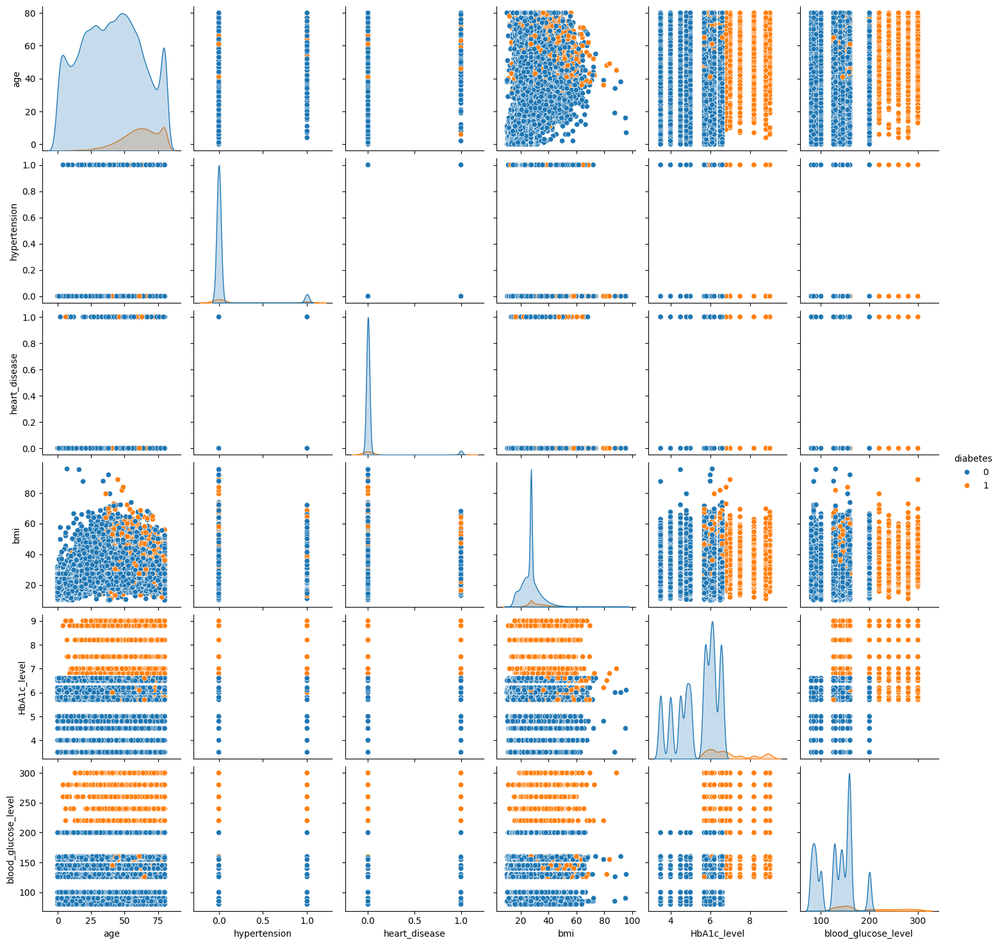

In [5]:
sns.pairplot(TRAIN_DATA, hue='diabetes')

Gracias a lo cual, entonces, podemos notar que las variables más relevantes que tenemos para la división de casos _con diabetes_ de los casos _sin diabetes_ son justamente las features: `HbA1c_level` y `blood_glucose_level`. Se puede observar dado que agrupando cualquier feature con una de ellas, se puede establecer un área marcada de división de los datos donde estamos asegurados que todos son de una misma clase.

Así mismo, la mejor combinación que notamos que se puede dar es la de `HbA1c_level` con `blood_glucose_level`, seguida por `bmi` con alguna de ellas. Por ello, uno podría pensar en considerar un dataset de predicción que solo contenga estas tres variables (lo tomaremos como una de las opciones posibles después).


### 4.3. Análisis de correlación


Vamos a analizar la correlación lineal entre las variables, para ver si hay alguna relación entre ellas que nos permita simplificar nuestro modelo o descartar algunas de las features.


In [6]:
numerical_columns = ['age', 'hypertension', 'heart_disease', 'bmi', 'HbA1c_level',
                     'blood_glucose_level', 'diabetes']
corr_matrix = TRAIN_DATA[numerical_columns].corr()

fig = go.Figure(data=go.Heatmap(z=corr_matrix, x=corr_matrix.columns,
                y=corr_matrix.columns, zmin=-1, zmax=1, zhoverformat='.2f', autocolorscale=True))
fig.update_layout(title='Matriz de correlación', height=600, width=800)
fig.show()

Gracias a lo cual podemos notar que no hay una correlación lineal fuerte entre las variables, por lo que no vamos a descartar ninguna de ellas con este método.

**Sin embargo**, algo importante que surge de este análisis es nuevamente la importancia de `HbA1c_level` y `blood_glucose_level` en la predicción de la diabetes, dado que son las variables que más correlación tienen con la variable objetivo ($0.40$ y $0.42$ respectivamente). Es decir, tienen una correlación moderada con la diabetes.

Este es un factor importantísimo a tener en cuenta, porque nos muestra que son _features_ que sí o sí debemos considerar para el armado de los modelos de predicción.


## 5. Preprocesamiento de datos


Ahora, habiendo analizado nuestro dataset, vamos a realizar el preprocesamiento de los datos para poder entrenar nuestro modelo de predicción de diabetes. Para ello, vamos a tener en cuenta que consideraremos tres _datasets_ preprocesados diferentes, para ver, luego, cuál es el que mejor performance tiene en la predicción final. Por este motivo, consideraremos:

- Un _dataset_ con únicamente las features de `HbA1c_level`, `blood_glucose_level` y `bmi`.
- Un _dataset_ con todas las features pero sin balancear (para ver _accuracy_).
- Un _dataset_ con todas las features pero balanceando las clases (para ver _balanced_accuracy_).

Por ello mismo, entonces, las transformaciones que realizaremos serán:

- Consideración de valores nulos en `gender` y `smoking_status`
- Reducción de categorías en `smoking_status`
- Eliminación de _features_ no relevantes
- División entre features y target
- Encoding de variables categóricas
- Imputación de valores nulos
- Escalado de variables
- Balanceo de clases


In [7]:
df = TRAIN_DATA.copy()

### 5.1. Consideración de valores nulos en `gender` y `smoking_status`


Para los dos datasets que contienen estas _features_, vamos a considerar que el género "Other" y el historial de tabaquismo "No Info" (sin información) son valores nulos (que no nos brindan información relevante), para luego poder imputarlos (luego del encoding correspondiente).

Por ello mismo, tenemos:


In [8]:
df_with_nans = df.copy()

df_with_nans['gender'] = df_with_nans['gender'].replace('Other', np.nan)
df_with_nans['smoking_history'] = df_with_nans['smoking_history'].replace(
    'No Info', np.nan)

display(pd.DataFrame(df_with_nans.isnull().sum(), columns=['NaNs']))

,NaNs
gender,16
age,0
hypertension,0
heart_disease,0
smoking_history,33958
bmi,0
HbA1c_level,0
blood_glucose_level,0
diabetes,0


### 5.2. Reducción de categorías en `smoking_status`


Como bien mencionamos anteriormente, `smoking_history` presenta varias categorías, las cuales podríamos agrupar para reducir el desbalance de la cantidad de datos que presenta en cada una de ellas. Si notamos, actualmente `smoking_history` se distribuye de la siguiente manera:


In [9]:
plot_simple_histogram(df_with_nans, 'smoking_history', 'diabetes')

Gracias a lo cual podemos notar que la categoría `Never` es la que más se repite, siendo de a $3$ a $9$ veces más que cada una de las demás categorías. En particular, ni sumando todas las demás categorías se llega a la cantidad de `Never`.

Por ello mismo, proponemos agrupar del siguiente modo:

- `never` por separado
- `not current` con `former`
- `current` con `ever`

De este modo, entonces, tendríamos una distribución más equitativa de los datos en cada categoría, lo cual nos permitiría tener un mejor análisis de la relación de esta variable con la diabetes. Esto lo podemos visualizar con el siguiente gráfico:


In [10]:
df_smoking_reduced = df_with_nans.copy()
df_smoking_reduced['smoking_history'] = df_smoking_reduced['smoking_history'].replace(
    {
        'not current': 'past',
        'former': 'past',
        'current': 'now',
        'ever': 'now'
    }
)

plot_simple_histogram(df_smoking_reduced, 'smoking_history', 'diabetes')

Y si vemos cómo se distribuye cada tipo de historial de tabaquismo con todas las demás variables, tenemos lo siguiente:


In [11]:
plot_all_histograms(df_smoking_reduced, 'smoking_history', 'diabetes')

Lo cual nos da una idea de cómo se relaciona el historial de tabaquismo con las demás variables y con la diabetes (siempre y cuando, teniendo en cuenta, por ejemplo para `age`, que un factor importante de la decisión de _fumar_ o no es la edad de la persona).


### 5.3. Eliminación de _features_ no relevantes


Para el _dataset_ con únicamente las _features_ de `HbA1c_level`, `blood_glucose_level` y `bmi`, deberemos eliminar las demás variables. Por ello mismo, consideramos:


In [12]:
df_with_relevant_features = df_smoking_reduced[[
    'bmi', 'HbA1c_level', 'blood_glucose_level', 'diabetes']].copy()

df_with_relevant_features.head()

,bmi,HbA1c_level,blood_glucose_level,diabetes
0,19.28,3.5,155,0
1,27.32,5.7,159,0
2,21.54,4.5,145,0
3,28.22,6.0,130,0
4,15.46,6.1,140,0


### 5.4. División entre features y target


Vamos a dividir nuestros datasets en dos partes: una con las _features_ y otra con la variable objetivo (`diabetes`).


In [13]:
# Dataset con las variables relevantes
y_with_relevant_features = df_with_relevant_features['diabetes']
X_with_relevant_features = df_with_relevant_features.drop('diabetes', axis=1)

# Datasets con todas las features
y = df_smoking_reduced['diabetes']
X = df_smoking_reduced.drop('diabetes', axis=1)

# Mostramos las primeras filas de los datasets
print('Dataset con las variables relevantes')
display(X_with_relevant_features.head())

print('Dataset con todas las features')
display(X.head())

print('Target')
display(pd.DataFrame(y).head())

Dataset con las variables relevantes


,bmi,HbA1c_level,blood_glucose_level
0,19.28,3.5,155
1,27.32,5.7,159
2,21.54,4.5,145
3,28.22,6.0,130
4,15.46,6.1,140


Dataset con todas las features


,gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level
0,Male,4,0,0,never,19.28,3.5,155
1,Female,50,0,0,past,27.32,5.7,159
2,Female,43,0,0,never,21.54,4.5,145
3,Male,64,0,0,now,28.22,6.0,130
4,Male,10,0,0,NaN,15.46,6.1,140


Target


,diabetes
0,0
1,0
2,0
3,0
4,0


### 5.5. Encoding de variables categóricas


Para poder trabajar con las variables categóricas, vamos a realizar un _encoding_ de las mismas. En particular, vamos a utilizar _Label Encoding_ para `gender` y `smoking_status` (y para seguir manteniendo los valores nulos).


In [14]:
X_encoded = X.apply(lambda series: pd.Series(
    LabelEncoder().fit_transform(series[series.notnull()]),
    index=series[series.notnull()].index
))

X_encoded.info()

<class 'pandas.core.frame.DataFrame'>
Index: 95000 entries, 0 to 94999
Data columns (total 8 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   gender               94984 non-null  float64
 1   age                  95000 non-null  int64  
 2   hypertension         95000 non-null  int64  
 3   heart_disease        95000 non-null  int64  
 4   smoking_history      61042 non-null  float64
 5   bmi                  95000 non-null  int64  
 6   HbA1c_level          95000 non-null  int64  
 7   blood_glucose_level  95000 non-null  int64  
dtypes: float64(2), int64(6)
memory usage: 6.5 MB


### 5.6. Imputación de valores nulos


Para el dataset con todas las features, consideraremos realizar la imputación de los valores nulos que contienen las columnas de `gender` y `smoking_status`. Para ello, vamos a utilizar la imputación simple por mediana.


In [15]:
imputing_strategy = 'median'

imputer = SimpleImputer(strategy=imputing_strategy)
X_imputed = pd.DataFrame(imputer.fit_transform(
    X_encoded), columns=X_encoded.columns)

X_imputed.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 95000 entries, 0 to 94999
Data columns (total 8 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   gender               95000 non-null  float64
 1   age                  95000 non-null  float64
 2   hypertension         95000 non-null  float64
 3   heart_disease        95000 non-null  float64
 4   smoking_history      95000 non-null  float64
 5   bmi                  95000 non-null  float64
 6   HbA1c_level          95000 non-null  float64
 7   blood_glucose_level  95000 non-null  float64
dtypes: float64(8)
memory usage: 5.8 MB


### 5.7. Escalado de variables


Ahora, vamos a escalar nuestras variables para que todas tengan la misma importancia en nuestro modelo. Para ello, vamos a utilizar el `RobustScaler` dado que es más robusto a los outliers que el `StandardScaler` (Z-score).


In [16]:
# Dataset con las variables relevantes
X_with_relevant_features_scaled = X_with_relevant_features.copy()
X_with_relevant_features_scaled = pd.DataFrame(
    RobustScaler().fit_transform(X_with_relevant_features_scaled),
    columns=X_with_relevant_features_scaled.columns
)

# Dataset con todas las features
X_scaled = X_imputed.copy()
X_scaled = pd.DataFrame(
    RobustScaler().fit_transform(X_scaled),
    columns=X_scaled.columns
)

# Mostramos las primeras filas de los datasets
print('Dataset con las variables relevantes')
display(X_with_relevant_features_scaled.head())

print('Dataset con todas las features')
display(X_scaled.head())

Dataset con las variables relevantes


,bmi,HbA1c_level,blood_glucose_level
0,-1.355818,-1.642857,0.254237
1,0.000000,-0.071429,0.322034
2,-0.974705,-0.928571,0.084746
3,0.151771,0.142857,-0.169492
4,-2.000000,0.214286,0.000000


Dataset con todas las features


,gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level
0,1.0,-1.083333,0.0,0.0,0.0,-1.355818,-1.000000,0.285714
1,0.0,0.194444,0.0,0.0,2.0,0.000000,-0.166667,0.571429
2,0.0,0.000000,0.0,0.0,0.0,-0.974705,-0.666667,0.142857
3,1.0,0.583333,0.0,0.0,1.0,0.151771,0.166667,-0.142857
4,1.0,-0.916667,0.0,0.0,0.0,-2.000000,0.333333,0.000000


### 5.8. Balanceo de clases


Ahora, realizaremos la última división de nuestros datos, que será en dos _datasets_, el cual uno de ellos tendrá las clases balanceadas y el otro no. Para ello, de todas las técnicas utilizadas durante la competencia (`RandomUnderSampling`, `RandomOverSampling`, `SMOTE` e `InstanceHardnessThreshold`), la que maximiza la _balanced_accuracy_ es la de _InstanceHardnessThreshold_.

Este método es un método de _undersampling_ que se basa en la dificultad de clasificación de cada instancia. Es decir, se calcula la probabilidad de que una instancia sea mal clasificada y se eliminan aquellas instancias que tienen una probabilidad alta de ser mal clasificadas. Para más información, se puede consultar el siguiente [link](https://imbalanced-learn.org/stable/references/generated/imblearn.under_sampling.InstanceHardnessThreshold.html).


In [17]:
# Dataset con datos no balanceados
y_imbalanced = y.copy()
X_imbalanced = X_scaled.copy()

# Dataset con datos balanceados
undersampler = InstanceHardnessThreshold(random_state=random_seed, n_jobs=-1)
X_balanced, y_balanced = undersampler.fit_resample(X_scaled, y)

# Mostramos la cantidad de datos por clase
print('Datos no balanceados')
display(pd.DataFrame(y_imbalanced.value_counts()))

print('Datos balanceados')
display(pd.DataFrame(y_balanced.value_counts()))

Datos no balanceados


,count
diabetes,
0,86918
1,8082


Datos balanceados


,count
diabetes,
0,60042
1,8082


## 6. Predicción de diabetes (Modelado)


Ahora, en este punto, vamos a realizar la elección de nuestro modelo de predicción de diabetes. Para ello, vamos a probar con varios modelos de clasificación y ver cuál es el que mejor se ajusta a nuestros datos.

Para cada uno de ellos, vamos a realizar una búsqueda de hiperparámetros con _GridSearchCV_ para encontrar los mejores hiperparámetros para nuestro modelo.

Además, vamos a realizar tres análisis, uno por cada _dataset_ que preprocesamos anteriormente:

- `X_with_relevant_features_scaled` e `y`
- `X_imbalanced` e `y_imbalanced`
- `X_balanced` e `y_balanced`


### 6.1. Funciones auxiliares


Usaremos las siguientes funciones que nos serán de suma utilidad para medir la calidad de nuestros modelos y nuestra `accuracy` o `balanced_accuracy` en el caso de los modelos con los hiperparámetros por defecto.


In [18]:
def get_metrics(model, X, y, n_splits=5):
    # Cross-validation
    cv = StratifiedKFold(n_splits=n_splits)
    metrics = cross_validate(model, X, y, cv=cv, n_jobs=-1,
                             scoring=['accuracy', 'precision', 'recall', 'f1', 'balanced_accuracy'])

    # Obtenemos la media y la desviación estándar de las métricas
    metrics = {k: (v.mean(), v.std()) for k, v in metrics.items()}
    return metrics


def get_default_models_performance(model_list, X, y, important_metric='accuracy', n_splits=5):
    # Obtenemos las métricas de los modelos
    results = []
    for model in model_list:
        print(f'Viendo {model.__class__.__name__}...')
        metrics = get_metrics(model, X, y, n_splits)
        results.append(metrics)

    # Mostrar los resultados
    header = ['model', 'fit_time', 'score_time', 'accuracy',
              'precision', 'recall', 'f1', 'balanced_accuracy']
    values = [[model.__class__.__name__] + [(round(v[0], 3), round(v[1], 3)) for v in metrics.values()]
              for model, metrics in zip(model_list, results)]

    df = pd.DataFrame(values, columns=header)
    df = df.sort_values(by=important_metric, ascending=False)

    return df

En torno a la búsqueda en particular de los hiperparámetros, usaremos `GridSearchCV` para encontrar los mejores hiperparámetros para nuestro modelo. Por ello mismo, entonces, vamos a usar las siguientes funciones que nos serán de suma utilidad:


In [19]:
def get_hyperparams_performance(model, X, y, param_grid, important_metric='accuracy', n_splits=5):
    # Cross-validation
    cv = StratifiedKFold(n_splits=n_splits)

    # Grid search
    grid_search = GridSearchCV(model, param_grid, cv=cv,
                               scoring=important_metric, n_jobs=-1)
    grid_search.fit(X, y)

    return pd.DataFrame(grid_search.cv_results_)


def show_hyperparams_performance(metrics, param_grid):
    header = [x for x in param_grid.keys()] + ['mean_test_score',
                                               'std_test_score']
    values = [metrics['param_' + x if i <
                      len(header) - 2 else x] for i, x in enumerate(header)]

    df = pd.DataFrame({k: v for k, v in zip(header, values)})
    df = df.sort_values('mean_test_score', ascending=False)
    df = df.round(5)

    fig = go.Figure(data=[go.Table(
        header=dict(values=list(df.columns)),
        cells=dict(values=[df[x] for x in df.columns]))
    ])
    fig.update_layout(title_text='Resultados de la Grid Search')
    fig.show()

Y, finalmente, utilizaremos la siguiente función auxiliar para facilitarnos la generación del _output_ de las predicciones de los modelos según el _dataset_ que estemos utilizando y las correspondientes transformaciones, para poder submitearlo de forma más sencilla y ágil a la competencia de Kaggle.


In [20]:
def generate_output(model, dataset_type, output_file=None):
    if output_file is None:
        output_file = f'output/{dataset_type}/{model.__class__.__name__}.csv'

    # Separamos las features, el target y el id de paciente
    test_data = TEST_DATA.copy()

    patient_id = test_data['patient']
    y_test = test_data['diabetes']
    X_test = test_data.drop(['diabetes', 'patient'], axis=1)

    # Realizamos las transformaciones según el tipo de dataset
    if dataset_type == 'relevant_columns':
        # Eliminación de columnas no relevantes
        X_test = X_test[['bmi', 'HbA1c_level', 'blood_glucose_level']]

        # Escalado de las features
        X_test = pd.DataFrame(RobustScaler().fit_transform(
            X_test), columns=X_test.columns)

    elif dataset_type == 'imbalanced' or dataset_type == 'balanced':
        # Consideración de valores nulos en gender y smoking_history
        X_test['gender'] = X_test['gender'].replace('Other', np.nan)
        X_test['smoking_history'] = X_test['smoking_history'].replace(
            'No Info', np.nan)

        # Reducción de la variable smoking_history
        X_test['smoking_history'] = X_test['smoking_history'].replace(
            {
                'not current': 'past',
                'former': 'past',
                'current': 'now',
                'ever': 'now'
            }
        )

        # Encoding de las variables categóricas
        X_test = X_test.apply(lambda series: pd.Series(
            LabelEncoder().fit_transform(series[series.notnull()]),
            index=series[series.notnull()].index
        ))

        # Imputación de valores nulos
        imputing_strategy = 'median'
        imputer = SimpleImputer(strategy=imputing_strategy)
        X_test = pd.DataFrame(imputer.fit_transform(
            X_test), columns=X_test.columns)

        # Escalado de las features
        X_test = pd.DataFrame(RobustScaler().fit_transform(
            X_test), columns=X_test.columns)

    else:
        assert False, 'Tipo de dataset no válido'

    # Hacemos la predicción
    y_pred = model.predict(X_test)

    # Escribimos los resultados en un archivo
    df = pd.DataFrame(list(zip(patient_id, np.int64(y_pred))),
                      columns=['patient', 'diabetes'])
    df.to_csv(f'{output_file}', index=False, header=True)

    print(f'Resultados escritos en {output_file}')
    return df

Con todo ello, entonces, podemos proceder con la elección de los modelos según cada uno de los datasets que preprocesamos anteriormente.


### 6.2. Predicción con dataset con _features_ relevantes


#### 6.2.1. Modelos de clasificación con hipérparámetros por defecto


En este punto, vamos a probar varios modelos de clasificación con sus hiperparámetros por defecto para ver cuál es el que mejor se ajusta a nuestros datos y usar este orden de modelos para realizar la búsqueda de hiperparámetros, con el objetivo de aumentar la eficiencia de la búsqueda.


In [21]:
rf_models = [
    KNeighborsClassifier(n_jobs=-1),
    LinearSVC(random_state=random_seed),
    DecisionTreeClassifier(random_state=random_seed),
    ExtraTreeClassifier(random_state=random_seed),
    LogisticRegression(n_jobs=-1, random_state=random_seed),
    RidgeClassifier(random_state=random_seed),
    SGDClassifier(n_jobs=-1, random_state=random_seed),
    PassiveAggressiveClassifier(n_jobs=-1, random_state=random_seed),
    ExtraTreesClassifier(n_jobs=-1, random_state=random_seed),
    RandomForestClassifier(n_jobs=-1, random_state=random_seed),
    GradientBoostingClassifier(random_state=random_seed),
    HistGradientBoostingClassifier(random_state=random_seed),
    XGBClassifier()
]

rd_models_performance = get_default_models_performance(
    rf_models, X_with_relevant_features_scaled, y)
rd_models_performance.to_csv(
    'tablas/relevant_columns/default_models_performance.csv', index=False)

fig = go.Figure(data=[go.Table(
    header=dict(values=list(rd_models_performance.columns)),
    cells=dict(values=[rd_models_performance[x] for x in rd_models_performance.columns]))
])
fig.update_layout(
    title_text='Métricas de los modelos con hiperparámetros por defecto')
fig.show()

Viendo KNeighborsClassifier...
Viendo LinearSVC...
Viendo DecisionTreeClassifier...
Viendo ExtraTreeClassifier...
Viendo LogisticRegression...
Viendo RidgeClassifier...
Viendo SGDClassifier...
Viendo PassiveAggressiveClassifier...
Viendo ExtraTreesClassifier...
Viendo RandomForestClassifier...
Viendo GradientBoostingClassifier...
Viendo HistGradientBoostingClassifier...
Viendo XGBClassifier...


Teniendo estos datos en cuenta, vamos a usar el orden dado por la tabla anterior para realizar la búsqueda de hiperparámetros para los primeros $4$ modelos con mayor _accuracy_. Es decir:

- `GradientBoostingClassifier`
- `HistGradientBoostingClassifier`
- `XGBClassifier`
- `KNeighborsClassifier`


#### 6.2.2. Modelos de clasificación con hiperparámetros optimizados


##### 6.2.2.1. GradientBoostingClassifier


In [22]:
rf_gradient_boosting = GradientBoostingClassifier(random_state=random_seed)
rf_gradient_boosting_param_grid = {
    'loss': ['exponential', 'log_loss'],
    'criterion': ['friedman_mse', 'squared_error'],
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 1],
}

rf_gradient_boosting_metrics = get_hyperparams_performance(
    rf_gradient_boosting, X_with_relevant_features_scaled, y, rf_gradient_boosting_param_grid)
rf_gradient_boosting_metrics.to_csv(
    'tablas/relevant_columns/gradient_boosting_hyperparams_performance.csv', index=False)

show_hyperparams_performance(
    rf_gradient_boosting_metrics, rf_gradient_boosting_param_grid)

Por lo que, entonces, las mejores combinaciones de hiperparámetros para el modelo `GradientBoostingClassifier` son:

- `loss`: exponential
- `criterion`: squared_error
- `n_estimators`: 50
- `learning_rate`: 0.1

Obteniendo una _accuracy_ promedio de $0.97183\pm 0.00104$.


In [23]:
rf_gradient_boosting_best_params = {
    'loss': 'exponential',
    'criterion': 'squared_error',
    'n_estimators': 50,
    'learning_rate': 0.1
}

# Mostrar las métricas del modelo con los mejores hiperparámetros
rf_gradient_boosting_best = GradientBoostingClassifier(
    random_state=random_seed, **rf_gradient_boosting_best_params)
metrics = get_metrics(rf_gradient_boosting_best,
                      X_with_relevant_features_scaled, y)
display(pd.DataFrame(metrics, index=['mean', 'std']))

# Entrenar el modelo y generar output
rf_gradient_boosting_best = GradientBoostingClassifier(
    random_state=random_seed, **rf_gradient_boosting_best_params)
rf_gradient_boosting_best.fit(X_with_relevant_features_scaled, y)

rf_gradient_boosting_predictions = generate_output(
    rf_gradient_boosting_best, 'relevant_columns')

,fit_time,score_time,test_accuracy,test_precision,test_recall,test_f1,test_balanced_accuracy
mean,1.622366,0.031597,0.971832,1.0,0.668895,0.801538,0.834447
std,0.016029,0.003105,0.001042,0.0,0.012212,0.008817,0.006106


Resultados escritos en output/relevant_columns/GradientBoostingClassifier.csv


Gracias a lo cual notamos que, en promedio, en nuestro conjunto de entrenamiento obtenemos una _accuracy_ del $97.182\%$ acertando a **todos** los casos que no tienen diabetes y errando los que sí la tienen. Por ello, la _balanced_accuracy_ es del $83.4447\%$.

Respecto a la competencia, obtenemos un resultado similar ya que:

- _Score público_: $0.97257$
- _Score privado_: $0.97266$

Por lo que mejora el `baseline` ($0.97257$) propuesto por la materia.


##### 6.2.2.2. HistGradientBoostingClassifier


In [24]:
rf_hist_gradient_boosting = HistGradientBoostingClassifier(
    random_state=random_seed)
rf_hist_gradient_boosting_param_grid = {
    'learning_rate': [0.01, 0.1, 0.5],
    'max_iter': [50, 100, 200],
    'max_leaf_nodes': [15, 31, 63],
    'l2_regularization': [0, 0.1, 0.5]
}

rf_hist_gradient_boosting_metrics = get_hyperparams_performance(
    rf_hist_gradient_boosting, X_with_relevant_features_scaled, y, rf_hist_gradient_boosting_param_grid)

rf_hist_gradient_boosting_metrics.to_csv(
    'tablas/relevant_columns/hist_gradient_boosting_hyperparams_performance.csv', index=False)

show_hyperparams_performance(
    rf_hist_gradient_boosting_metrics, rf_hist_gradient_boosting_param_grid)

Por lo que, entonces, las mejores combinaciones de hiperparámetros para el modelo `HistGradientBoostingClassifier` son:

- `learning_rate`: $0.01$
- `max_iter`: $100$
- `max_leaf_nodes`: $31$
- `l2_regularization`: $0.1$

Obteniendo una _accuracy_ promedio de $0.97183\pm 0.00104$.


In [25]:
rf_hist_gradient_boosting_best_params = {
    'learning_rate': 0.01,
    'max_iter': 100,
    'max_leaf_nodes': 31,
    'l2_regularization': 0.1
}

# Mostrar las métricas del modelo con los mejores hiperparámetros
rf_hist_gradient_boosting_best = HistGradientBoostingClassifier(
    random_state=random_seed, **rf_hist_gradient_boosting_best_params)
metrics = get_metrics(rf_hist_gradient_boosting_best,
                      X_with_relevant_features_scaled, y)
display(pd.DataFrame(metrics, index=['mean', 'std']))

# Entrenar el modelo y generar output
rf_hist_gradient_boosting_best = HistGradientBoostingClassifier(
    random_state=random_seed, **rf_hist_gradient_boosting_best_params)
rf_hist_gradient_boosting_best.fit(X_with_relevant_features_scaled, y)

rf_hist_gradient_boosting_predictions = generate_output(
    rf_hist_gradient_boosting_best, 'relevant_columns')

,fit_time,score_time,test_accuracy,test_precision,test_recall,test_f1,test_balanced_accuracy
mean,0.999535,0.204372,0.971832,1.0,0.668895,0.801538,0.834447
std,0.017621,0.003260,0.001042,0.0,0.012212,0.008817,0.006106


Resultados escritos en output/relevant_columns/HistGradientBoostingClassifier.csv


Gracias a lo cual notamos que, en promedio, en nuestro conjunto de entrenamiento obtenemos una _accuracy_ del $97.1832\%$ acertando a **todos** los casos que no tienen diabetes y errando los que sí la tienen. Por ello, la _balanced_accuracy_ es del $83.4447\%$.

Respecto a la competencia, obtenemos un resultado similar (igual al anterior modelo) ya que:

- _Score público_: $0.97257$
- _Score privado_: $0.97266$

Por lo que mejora el `baseline` ($0.97257$) propuesto por la materia.


##### 6.2.2.3. XGBClassifier


In [26]:
rf_xgb = XGBClassifier(random_state=random_seed)
rf_xgb_param_grid = {
    'n_estimators': [50, 100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.5],
    'max_depth': [3, 5, 7, 9],
    'n_jobs': [-1],
}

rf_xgb_metrics = get_hyperparams_performance(
    rf_xgb, X_with_relevant_features_scaled, y, rf_xgb_param_grid)

rf_xgb_metrics.to_csv(
    'tablas/relevant_columns/xgb_hyperparams_performance.csv', index=False)

show_hyperparams_performance(rf_xgb_metrics, rf_xgb_param_grid)

Por lo que, entonces, las mejores combinaciones de hiperparámetros para el modelo `XGBClassifier` son:

- `n_estimators`: $50$
- `learning_rate`: $0.1$
- `max_depth`: $7$

Obteniendo una _accuracy_ promedio de $0.97183\pm 0.00104$.


In [27]:
rf_xgb_best_params = {
    'n_estimators': 50,
    'learning_rate': 0.1,
    'max_depth': 7,
    'n_jobs': -1
}

# Mostrar las métricas del modelo con los mejores hiperparámetros
rf_xgb_best = XGBClassifier(random_state=random_seed, **rf_xgb_best_params)
metrics = get_metrics(rf_xgb_best, X_with_relevant_features_scaled, y)
display(pd.DataFrame(metrics, index=['mean', 'std']))

# Entrenar el modelo y generar output
rf_xgb_best = XGBClassifier(random_state=random_seed, **rf_xgb_best_params)
rf_xgb_best.fit(X_with_relevant_features_scaled, y)

rf_xgb_predictions = generate_output(rf_xgb_best, 'relevant_columns')

,fit_time,score_time,test_accuracy,test_precision,test_recall,test_f1,test_balanced_accuracy
mean,0.176368,0.033799,0.971832,1.0,0.668895,0.801538,0.834447
std,0.010610,0.003189,0.001042,0.0,0.012212,0.008817,0.006106


Resultados escritos en output/relevant_columns/XGBClassifier.csv


Gracias a lo cual notamos que el resultado es exactamente el mismo que en los anteriores casos:

- _Accuracy_ de entrenamiento del $97.1832\%$
- En entrenamiento le acierta a todos los casos sin diabetes y erra varios que sí la tienen
- Competencia de Kaggle:
  - _Score público_: $0.97257$
  - _Score privado_: $0.97266$

Por lo que sigue mejorando el `baseline` ($0.97257$) propuesto por la materia, pero no presenta alguna diferencia con los anteriores modelos.


##### 6.2.2.4. KNeighborsClassifier


In [28]:
rf_knn = KNeighborsClassifier()
rf_knn_param_grid = {
    'n_neighbors': [3, 5, 7, 9],
    'weights': [None, 'uniform', 'distance'],
    'p': [1, 2],
    'n_jobs': [-1],
}

rf_knn_metrics = get_hyperparams_performance(
    rf_knn, X_with_relevant_features_scaled, y, rf_knn_param_grid)

rf_knn_metrics.to_csv(
    'tablas/relevant_columns/knn_hyperparams_performance.csv', index=False)

show_hyperparams_performance(rf_knn_metrics, rf_knn_param_grid)

Por lo que, entonces, las mejores combinaciones de hiperparámetros para el modelo `KNeighborsClassifier` son:

- `n_neighbors`: $9$
- `weights`: uniform
- `p`: $1$

Obteniendo una _accuracy_ promedio de $0.97003\pm 0.00078$. Es decir, un poco peor que los anteriores modelos.


In [29]:
rf_knn_best_params = {
    'n_neighbors': 9,
    'weights': 'uniform',
    'p': 1,
    'n_jobs': -1
}

# Mostrar las métricas del modelo con los mejores hiperparámetros
rf_knn_best = KNeighborsClassifier(**rf_knn_best_params)
metrics = get_metrics(rf_knn_best, X_with_relevant_features_scaled, y)
display(pd.DataFrame(metrics, index=['mean', 'std']))

# Entrenar el modelo y generar output
rf_knn_best = KNeighborsClassifier(**rf_knn_best_params)
rf_knn_best.fit(X_with_relevant_features_scaled, y)

rf_knn_predictions = generate_output(rf_knn_best, 'relevant_columns')

,fit_time,score_time,test_accuracy,test_precision,test_recall,test_f1,test_balanced_accuracy
mean,0.101636,0.866423,0.970032,0.984861,0.657883,0.788763,0.828470
std,0.015188,0.023609,0.000784,0.003393,0.010698,0.007060,0.005271


Resultados escritos en output/relevant_columns/KNeighborsClassifier.csv


Gracias a lo cual notamos que, en promedio, en nuestro conjunto de entrenamiento obtenemos una _accuracy_ del $97.0032\%$ y con una _balanced_accuracy_ del $82.8470\%$.

Respecto a la competencia, obtenemos un resultado peor que los anteriores modelos ya que:

- _Score público_: $0.97142$
- _Score privado_: $0.97133$

Por lo que **no** mejora el `baseline` ($0.97257$) propuesto por la materia.


#### 6.2.3. Conclusiones


Por este motivo, entonces, podemos ver que si consideramos el _dataset_ que contiene **únicamente** las features que más relevancia tienen para nuestra predicción de la diabetes en el dataset, llega un punto que existen pacientes _con diabetes_ que no podemos distinguir utilizando solo estas variables. Es decir, necesitamos valernos de más información para poder clasificar estos casos.

Por ello mismo, llegamos a la conclusión de que este método es suficiente para lograr superar el `baseline` propuesto por la materia, pero que puede mejorar mucho más para obtener una mejor predicción. En particular, de los modelos considerados, tenemos que:

- `GradientBoostingClassifier`
- `HistGradientBoostingClassifier`
- `XGBClassifier`

Logran un score privado de $0.97266$, mientras que `KNeighborsClassifier` logra un score privado de $0.97133$.


### 6.3. Predicción con dataset sin balancear


Ahora, vamos a realizar la predicción de la diabetes con el _dataset_ que contiene todas las _features_ pero sin balancear las clases. Por ello mismo, seguiremos considerando como "meta" mejorar la _accuracy_ general del modelo.


#### 6.3.1. Modelos de clasificación con hipérparámetros por defecto


En este punto, vamos a probar varios modelos de clasificación con sus hiperparámetros por defecto para ver cuál es el que mejor se ajusta a nuestros datos y usar este orden de modelos para realizar la búsqueda de hiperparámetros, con el objetivo de aumentar la eficiencia de la búsqueda.


In [30]:
imb_models = [
    KNeighborsClassifier(n_jobs=-1),
    LinearSVC(random_state=random_seed),
    DecisionTreeClassifier(random_state=random_seed),
    ExtraTreeClassifier(random_state=random_seed),
    LogisticRegression(n_jobs=-1, random_state=random_seed),
    RidgeClassifier(random_state=random_seed),
    SGDClassifier(n_jobs=-1, random_state=random_seed),
    PassiveAggressiveClassifier(n_jobs=-1, random_state=random_seed),
    ExtraTreesClassifier(n_jobs=-1, random_state=random_seed),
    RandomForestClassifier(n_jobs=-1, random_state=random_seed),
    GradientBoostingClassifier(random_state=random_seed),
    HistGradientBoostingClassifier(random_state=random_seed),
    XGBClassifier()
]

imb_models_performance = get_default_models_performance(
    imb_models, X_imbalanced, y_imbalanced)
imb_models_performance.to_csv(
    'tablas/imbalanced/default_models_performance.csv', index=False)

fig = go.Figure(data=[go.Table(
    header=dict(values=list(imb_models_performance.columns)),
    cells=dict(values=[imb_models_performance[x] for x in imb_models_performance.columns]))
])
fig.update_layout(
    title_text='Métricas de los modelos con hiperparámetros por defecto')
fig.show()

Viendo KNeighborsClassifier...
Viendo LinearSVC...
Viendo DecisionTreeClassifier...
Viendo ExtraTreeClassifier...
Viendo LogisticRegression...
Viendo RidgeClassifier...
Viendo SGDClassifier...
Viendo PassiveAggressiveClassifier...
Viendo ExtraTreesClassifier...
Viendo RandomForestClassifier...
Viendo GradientBoostingClassifier...
Viendo HistGradientBoostingClassifier...
Viendo XGBClassifier...


Teniendo estos datos en cuenta, vamos a usar el orden dado por la tabla anterior para realizar la búsqueda de hiperparámetros para los primeros $4$ modelos con mayor _accuracy_. Es decir:

- `GradientBoostingClassifier`
- `HistGradientBoostingClassifier`
- `XGBClassifier`
- `RandomForestClassifier`


#### 6.3.2. Modelos de clasificación con hiperparámetros optimizados


##### 6.3.2.1. GradientBoostingClassifier


In [31]:
imb_gradient_boosting = GradientBoostingClassifier(random_state=random_seed)
imb_gradient_boosting_param_grid = {
    'loss': ['exponential', 'log_loss'],
    'criterion': ['friedman_mse', 'squared_error'],
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 1],
}

imb_gradient_boosting_metrics = get_hyperparams_performance(
    imb_gradient_boosting, X_imbalanced, y_imbalanced, imb_gradient_boosting_param_grid)

imb_gradient_boosting_metrics.to_csv(
    'tablas/imbalanced/gradient_boosting_hyperparams_performance.csv', index=False)

show_hyperparams_performance(
    imb_gradient_boosting_metrics, imb_gradient_boosting_param_grid)

Por lo que, entonces, las mejores combinaciones de hiperparámetros para el modelo `GradientBoostingClassifier` son:

- `loss`: exponential
- `criterion`: squared_error
- `n_estimators`: $200$
- `learning_rate`: $0.1$

Obteniendo una _accuracy_ promedio de $0.97189\pm 0.001$.


In [32]:
imb_gradient_boosting_best_params = {
    'loss': 'exponential',
    'criterion': 'squared_error',
    'n_estimators': 200,
    'learning_rate': 0.1
}

# Mostrar las métricas del modelo con los mejores hiperparámetros
imb_gradient_boosting_best = GradientBoostingClassifier(
    random_state=random_seed, **imb_gradient_boosting_best_params)
metrics = get_metrics(imb_gradient_boosting_best, X_imbalanced, y_imbalanced)
display(pd.DataFrame(metrics, index=['mean', 'std']))

# Entrenar el modelo y generar output
imb_gradient_boosting_best = GradientBoostingClassifier(
    random_state=random_seed, **imb_gradient_boosting_best_params)
imb_gradient_boosting_best.fit(X_imbalanced, y_imbalanced)

imb_gradient_boosting_predictions = generate_output(
    imb_gradient_boosting_best, 'imbalanced')

,fit_time,score_time,test_accuracy,test_precision,test_recall,test_f1,test_balanced_accuracy
mean,9.142746,0.053381,0.971895,0.983218,0.681268,0.804800,0.840093
std,0.040593,0.001065,0.001005,0.003203,0.011465,0.008254,0.005738


Resultados escritos en output/imbalanced/GradientBoostingClassifier.csv


Gracias a lo cual notamos que, en promedio, en nuestro conjunto de entrenamiento obtenemos una _accuracy_ del $97.1895\%$ y la _balanced_accuracy_ es del $84.0093\%$.

Respecto a la competencia, obtenemos un también un resultado levemente mejor que con los modelos con el otro dataset ya que:

- _Score público_: $0.97314$
- _Score privado_: $0.97266$

Por lo que mejora el `baseline` ($0.97257$) propuesto por la materia, pero aún no hemos superado el _score_ privado de los modelos con el dataset con _features_ relevantes.


##### 6.3.2.2. HistGradientBoostingClassifier


In [33]:
imb_hist_gradient_boosting = HistGradientBoostingClassifier(
    random_state=random_seed)
imb_hist_gradient_boosting_param_grid = {
    'learning_rate': [0.01, 0.1, 0.5],
    'max_iter': [50, 100, 200],
    'max_leaf_nodes': [15, 31, 63],
    'l2_regularization': [0, 0.1, 0.5]
}

imb_hist_gradient_boosting_metrics = get_hyperparams_performance(
    imb_hist_gradient_boosting, X_imbalanced, y_imbalanced, imb_hist_gradient_boosting_param_grid)

imb_hist_gradient_boosting_metrics.to_csv(
    'tablas/imbalanced/hist_gradient_boosting_hyperparams_performance.csv', index=False)

show_hyperparams_performance(
    imb_hist_gradient_boosting_metrics, imb_hist_gradient_boosting_param_grid)

Por lo que, entonces, las mejores combinaciones de hiperparámetros para el modelo `HistGradientBoostingClassifier` son:

- `learning_rate`: $0.1$
- `max_iter`: $50$
- `max_leaf_nodes`: $31$
- `l2_regularization`: $0$

Obteniendo una _accuracy_ promedio de $0.97206\pm 0.00103$.


In [34]:
imb_hist_gradient_boosting_best_params = {
    'learning_rate': 0.1,
    'max_iter': 50,
    'max_leaf_nodes': 31,
    'l2_regularization': 0
}

# Mostrar las métricas del modelo con los mejores hiperparámetros
imb_hist_gradient_boosting_best = HistGradientBoostingClassifier(
    random_state=random_seed, **imb_hist_gradient_boosting_best_params)
metrics = get_metrics(imb_hist_gradient_boosting_best,
                      X_imbalanced, y_imbalanced)
display(pd.DataFrame(metrics, index=['mean', 'std']))

# Entrenar el modelo y generar output
imb_hist_gradient_boosting_best = HistGradientBoostingClassifier(
    random_state=random_seed, **imb_hist_gradient_boosting_best_params)
imb_hist_gradient_boosting_best.fit(X_imbalanced, y_imbalanced)

imb_hist_gradient_boosting_predictions = generate_output(
    imb_hist_gradient_boosting_best, 'imbalanced')

,fit_time,score_time,test_accuracy,test_precision,test_recall,test_f1,test_balanced_accuracy
mean,0.684645,0.109736,0.972063,0.986012,0.681268,0.805744,0.840185
std,0.016570,0.002641,0.001030,0.001629,0.011283,0.008382,0.005678


Resultados escritos en output/imbalanced/HistGradientBoostingClassifier.csv


Gracias a lo cual notamos que, en promedio, en nuestro conjunto de entrenamiento obtenemos una _accuracy_ del $97.2063\%$ y la _balanced_accuracy_ es del $84.0185\%$. Es decir, es levemente mejor que el anterior modelo.

Sin embargo, respecto a la competencia, obtenemos un resultado similar ya que:

- _Score público_: $0.97314$
- _Score privado_: $0.97266$

Por lo que mejora el `baseline` ($0.97257$) propuesto por la materia, pero aún no hemos superado el _score_ privado de los modelos con el dataset con _features_ relevantes.


##### 6.3.2.3. XGBClassifier


In [35]:
imb_xgb = XGBClassifier(random_state=random_seed)
imb_xgb_param_grid = {
    'n_estimators': [50, 100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.5],
    'max_depth': [3, 5, 7, 9],
    'n_jobs': [-1],
}

imb_xgb_metrics = get_hyperparams_performance(
    imb_xgb, X_imbalanced, y_imbalanced, imb_xgb_param_grid)

imb_xgb_metrics.to_csv(
    'tablas/imbalanced/xgb_hyperparams_performance.csv', index=False)

show_hyperparams_performance(imb_xgb_metrics, imb_xgb_param_grid)

Por lo que, entonces, las mejores combinaciones de hiperparámetros para el modelo `XGBClassifier` son:

- `n_estimators`: $50$
- `learning_rate`: $0.1$
- `max_depth`: $9$

Obteniendo una _accuracy_ promedio de $0.97207\pm 0.00114$.


In [36]:
imb_xgb_best_params = {
    'n_estimators': 50,
    'learning_rate': 0.1,
    'max_depth': 9,
    'n_jobs': -1
}

# Mostrar las métricas del modelo con los mejores hiperparámetros
imb_xgb_best = XGBClassifier(random_state=random_seed, **imb_xgb_best_params)
metrics = get_metrics(imb_xgb_best, X_imbalanced, y_imbalanced)
display(pd.DataFrame(metrics, index=['mean', 'std']))

# Entrenar el modelo y generar output
imb_xgb_best = XGBClassifier(random_state=random_seed, **imb_xgb_best_params)
imb_xgb_best.fit(X_imbalanced, y_imbalanced)

imb_xgb_predictions = generate_output(imb_xgb_best, 'imbalanced')

,fit_time,score_time,test_accuracy,test_precision,test_recall,test_f1,test_balanced_accuracy
mean,0.299303,0.045093,0.972074,0.984135,0.682753,0.806129,0.840864
std,0.012241,0.002730,0.001136,0.004242,0.012846,0.009290,0.006432


Resultados escritos en output/imbalanced/XGBClassifier.csv


Gracias a lo cual notamos que, en promedio, en nuestro conjunto de entrenamiento obtenemos una _accuracy_ del $97.2074\%$ y la _balanced_accuracy_ es del $84.0864\%$. Es decir, es levemente mejor que el anterior modelo.

Sin embargo, respecto a la competencia, obtenemos un resultado similar ya que:

- _Score público_: $0.97342$
- _Score privado_: $0.97266$

Por lo que mejora el `baseline` ($0.97257$) propuesto por la materia, pero aún no hemos superado el _score_ privado de los modelos con el dataset con _features_ relevantes.


##### 6.3.2.4. RandomForestClassifier


In [37]:
imb_random_forest = RandomForestClassifier(random_state=random_seed)
imb_random_forest_param_grid = {
    'n_estimators': [50, 100, 200],
    'criterion': ['gini', 'entropy'],
    'max_depth': [None, 5, 10],
    'n_jobs': [-1],
}

imb_random_forest_metrics = get_hyperparams_performance(
    imb_random_forest, X_imbalanced, y_imbalanced, imb_random_forest_param_grid)

imb_random_forest_metrics.to_csv(
    'tablas/imbalanced/random_forest_hyperparams_performance.csv', index=False)

show_hyperparams_performance(
    imb_random_forest_metrics, imb_random_forest_param_grid)

Por lo que, entonces, las mejores combinaciones de hiperparámetros para el modelo `RandomForestClassifier` son:

- `n_estimators`: $100$
- `criterion`: gini
- `max_depth`: $10$

Obteniendo una _accuracy_ promedio de $0.97187\pm 0.00096$.


In [38]:
imb_random_forest_best_params = {
    'n_estimators': 200,
    'criterion': 'gini',
    'max_depth': 10,
    'n_jobs': -1
}

# Mostrar las métricas del modelo con los mejores hiperparámetros
imb_random_forest_best = RandomForestClassifier(
    random_state=random_seed, **imb_random_forest_best_params)
metrics = get_metrics(imb_random_forest_best, X_imbalanced, y_imbalanced)
display(pd.DataFrame(metrics, index=['mean', 'std']))

# Entrenar el modelo y generar output
imb_random_forest_best = RandomForestClassifier(
    random_state=random_seed, **imb_random_forest_best_params)
imb_random_forest_best.fit(X_imbalanced, y_imbalanced)

imb_random_forest_predictions = generate_output(
    imb_random_forest_best, 'imbalanced')

,fit_time,score_time,test_accuracy,test_precision,test_recall,test_f1,test_balanced_accuracy
mean,3.80643,0.906826,0.971821,0.998906,0.669514,0.801626,0.834722
std,0.70891,0.680558,0.000987,0.000884,0.012038,0.008455,0.005997


Resultados escritos en output/imbalanced/RandomForestClassifier.csv


Gracias a lo cual notamos que, en promedio, en nuestro conjunto de entrenamiento obtenemos una _accuracy_ del $97.1821\%$ y la _balanced_accuracy_ es del $83.4722\%$. Es decir, es levemente peor que el anterior modelo.

Sin embargo, respecto a la competencia, obtenemos un resultado similar ya que:

- _Score público_: $0.97257$
- _Score privado_: $0.97266$

Por lo que mejora el `baseline` ($0.97257$) propuesto por la materia, pero aún no hemos superado el _score_ privado de los modelos con el dataset con _features_ relevantes.


#### 6.3.3. Conclusiones


Por todo ello, entonces, si consideramos el _dataset_ que no se encuentra balanceado, llegamos a la conclusión de que los modelos considerados siguen presentando la misma barrera que anteriormente se comentó. Es decir, se traban en el score privado de $0.97266$ por más que en entrenamiento sean mejores que los modelos con el _dataset_ con _features_ relevantes.

Es decir, notamos que aún necesitamos algo más a considerar para poder mejorar la predicción de la diabetes en estos casos (al final del trabajo se discutirá la "idea de mejora" que se nos ocurrió para poder superar esta barrera).


### 6.4. Predicción con dataset balanceado


Ahora, vamos a realizar la predicción de la diabetes con el _dataset_ que contiene todas las _features_ pero balanceando las clases. Por ello mismo, consideraremos, a diferencia de todos los anteriores casos, que la _balanced_accuracy_ es la métrica más importante a considerar para la evaluación de los modelos.

Realmente, según la explicación de la competencia, la _balanced_accuracy_ es la métrica que se utiliza para evaluar los modelos, pero en la práctica nos hemos dado cuenta que no es así. Por ello mismo, vamos a notar un considerable decaimiento en los resultados de la competencia en esta sección, pero quisimos igualmente incluirlo para mostrar cómo se realizaría y expresar esta situación.


#### 6.4.1. Modelos de clasificación con hipérparámetros por defecto


En este punto, vamos a probar varios modelos de clasificación con sus hiperparámetros por defecto para ver cuál es el que mejor se ajusta a nuestros datos y usar este orden de modelos para realizar la búsqueda de hiperparámetros, con el objetivo de aumentar la eficiencia de la búsqueda.


In [39]:
bal_models = [
    KNeighborsClassifier(n_jobs=-1),
    LinearSVC(random_state=random_seed),
    DecisionTreeClassifier(random_state=random_seed),
    ExtraTreeClassifier(random_state=random_seed),
    LogisticRegression(n_jobs=-1, random_state=random_seed),
    RidgeClassifier(random_state=random_seed),
    SGDClassifier(n_jobs=-1, random_state=random_seed),
    PassiveAggressiveClassifier(n_jobs=-1, random_state=random_seed),
    ExtraTreesClassifier(n_jobs=-1, random_state=random_seed),
    RandomForestClassifier(n_jobs=-1, random_state=random_seed),
    GradientBoostingClassifier(random_state=random_seed),
    HistGradientBoostingClassifier(random_state=random_seed),
    XGBClassifier()
]

bal_models_performance = get_default_models_performance(
    bal_models, X_balanced, y_balanced, important_metric='balanced_accuracy')
bal_models_performance.to_csv(
    'tablas/balanced/default_models_performance.csv', index=False)

fig = go.Figure(data=[go.Table(
    header=dict(values=list(bal_models_performance.columns)),
    cells=dict(values=[bal_models_performance[x] for x in bal_models_performance.columns]))
])
fig.update_layout(
    title_text='Métricas de los modelos con hiperparámetros por defecto')
fig.show()

Viendo KNeighborsClassifier...
Viendo LinearSVC...
Viendo DecisionTreeClassifier...
Viendo ExtraTreeClassifier...
Viendo LogisticRegression...
Viendo RidgeClassifier...
Viendo SGDClassifier...
Viendo PassiveAggressiveClassifier...
Viendo ExtraTreesClassifier...
Viendo RandomForestClassifier...
Viendo GradientBoostingClassifier...
Viendo HistGradientBoostingClassifier...
Viendo XGBClassifier...


Gracias a lo cual, entonces, vamos a considerar solo la mejor combinación de hiperparámetros para cada uno de los modelos, dado que es solo para mostrar el decaimiento en el score de la competencia. Es decir, consideraremos `XGBClassifier`.


#### 6.4.2. Modelos de clasificación con hiperparámetros optimizados


##### 6.4.2.1. XGBClassifier


In [40]:
bal_xgb = XGBClassifier(random_state=random_seed)
bal_xgb_param_grid = {
    'n_estimators': [50, 100, 200, 300],
    'learning_rate': [0.01, 0.1, 0.5],
    'max_depth': [3, 5, 7, 9],
    'n_jobs': [-1],
}

bal_xgb_metrics = get_hyperparams_performance(
    bal_xgb, X_balanced, y_balanced, bal_xgb_param_grid, important_metric='balanced_accuracy')

bal_xgb_metrics.to_csv(
    'tablas/balanced/xgb_hyperparams_performance.csv', index=False)

show_hyperparams_performance(bal_xgb_metrics, bal_xgb_param_grid)

Por lo que, entonces, las mejores combinaciones de hiperparámetros para el modelo `XGBClassifier` son:

- `n_estimators`: $300$
- `learning_rate`: $0.5$
- `max_depth`: $7$

Obteniendo una _balanced_accuracy_ promedio de $0.97078\pm 0.00266$.


In [41]:
bal_xgb_best_params = {
    'n_estimators': 300,
    'learning_rate': 0.5,
    'max_depth': 7,
    'n_jobs': -1
}

# Mostrar las métricas del modelo con los mejores hiperparámetros
bal_xgb_best = XGBClassifier(random_state=random_seed, **bal_xgb_best_params)
metrics = get_metrics(bal_xgb_best, X_balanced, y_balanced)
display(pd.DataFrame(metrics, index=['mean', 'std']))

# Entrenar el modelo y generar output
bal_xgb_best = XGBClassifier(random_state=random_seed, **bal_xgb_best_params)
bal_xgb_best.fit(X_balanced, y_balanced)

bal_xgb_predictions = generate_output(bal_xgb_best, 'balanced')

,fit_time,score_time,test_accuracy,test_precision,test_recall,test_f1,test_balanced_accuracy
mean,1.021448,0.131642,0.99040,0.973295,0.945062,0.958941,0.970782
std,0.073113,0.016801,0.00026,0.004836,0.005938,0.001240,0.002660


Resultados escritos en output/balanced/XGBClassifier.csv


Y, con ello, notamos que, pese a que en entrenamiento obtenemos una _balanced_accuracy_ del $97.0782\%$, en la competencia obtenemos un resultado mucho peor:

- _Score público_: $0.88600$
- _Score privado_: $0.87933$

El cual, claramente, no supera el `baseline` ($0.97257$) propuesto por la materia. Es por ello, que nos dimos cuenta que realmente la competencia no utiliza la _balanced_accuracy_ como métrica de evaluación, sino que utiliza la _accuracy_ (lo probamos con muchísimos más casos, claro).


#### 6.4.3. Conclusiones


La conclusión para este caso es la misma que mencionamos recién: la competencia no utiliza la _balanced_accuracy_ como métrica de evaluación, sino que utiliza la _accuracy_. Por ello mismo, notamos un decaimiento en los resultados de la competencia en esta sección, pero quisimos igualmente incluirlo para mostrar cómo se haría.


## 7. Idea de mejora


Notando todo lo anterior, lo que se nos ocurrió realizar es utilizar el dataset no balanceado con todas las _features_, pero considerando la importancia que tienen `HbA1c_level` y `blood_glucose_level` en la predicción de la diabetes. Por ello mismo, entonces, vamos a utilizar la observación que realizamos durante el análisis descriptivo de los datos:

- `HbA1c_level` y `blood_glucose_level` son las variables más importantes para la predicción de la diabetes
- Para `HbA1c_level`, si el valor es mayor estricto a $6.6$, la persona tiene diabetes, mientras que si es menor estricto a $5.7$, no la tiene
- Para `blood_glucose_level`, si el valor es mayor estricto a $200$, la persona tiene diabetes, mientras que si es menor estricto a $126$, no la tiene

Por este motivo, entonces, vamos a considerar el dataset sin estos casos extremos para realizar el modelado y, para todo dato que esté en estos situaciones, vamos a aplicar la regla de clasificación por observación.

Por ello mismo, vamos a realizar todo el mismo preprocesamiento que se realizó anteriormente, pero sacando del dataset de entrenamiento estos casos extremos:


In [42]:
df_idea = TRAIN_DATA.copy()

# Consideración de valores nulos en gender y smoking_history
df_idea['gender'] = df_idea['gender'].replace('Other', np.nan)
df_idea['smoking_history'] = df_idea['smoking_history'].replace(
    'No Info', np.nan)

# Reducción de la variable smoking_history
df_idea['smoking_history'] = df_idea['smoking_history'].replace(
    {
        'not current': 'past',
        'former': 'past',
        'current': 'now',
        'ever': 'now'
    }
)

# Eliminación de casos extremos
condition_D = (df_idea['HbA1c_level'] > 6.6) | (
    df_idea['blood_glucose_level'] > 200)
condition_ND = (df_idea['HbA1c_level'] < 5.7) | (
    df_idea['blood_glucose_level'] < 126)

df_idea = df_idea[~(condition_D | condition_ND)]

# División entre features y target
y_idea = df_idea['diabetes']
X_idea = df_idea.drop('diabetes', axis=1)

# Encoding de las variables categóricas
X_idea = X_idea.apply(lambda series: pd.Series(
    LabelEncoder().fit_transform(series[series.notnull()]),
    index=series[series.notnull()].index
))

# Imputación de valores nulos
imputing_strategy = 'median'
imputer = SimpleImputer(strategy=imputing_strategy)
X_idea = pd.DataFrame(imputer.fit_transform(
    X_idea), columns=X_idea.columns)

# Escalado de las features
X_idea = pd.DataFrame(RobustScaler().fit_transform(
    X_idea), columns=X_idea.columns)

Y tomaremos en cuenta la siguiente nueva función que nos generará el _output_ aplicando la regla de "corrección" antes mencionada:


In [43]:
def generate_output_with_correction(model, output_file=None):
    if output_file is None:
        output_file = f'output/idea/{model.__class__.__name__}.csv'

    # Separamos las features, el target y el id de paciente
    test_data = TEST_DATA.copy()

    condition_D = (test_data['HbA1c_level'] > 6.6) | (
        test_data['blood_glucose_level'] > 200)
    condition_ND = (test_data['HbA1c_level'] < 5.7) | (
        test_data['blood_glucose_level'] < 126)

    patient_id = test_data['patient']
    X_test = test_data.drop(['diabetes', 'patient'], axis=1)

    # Consideración de valores nulos en gender y smoking_history
    X_test['gender'] = X_test['gender'].replace('Other', np.nan)
    X_test['smoking_history'] = X_test['smoking_history'].replace(
        'No Info', np.nan)

    # Reducción de la variable smoking_history
    X_test['smoking_history'] = X_test['smoking_history'].replace(
        {
            'not current': 'past',
            'former': 'past',
            'current': 'now',
            'ever': 'now'
        }
    )

    # Encoding de las variables categóricas
    X_test = X_test.apply(lambda series: pd.Series(
        LabelEncoder().fit_transform(series[series.notnull()]),
        index=series[series.notnull()].index
    ))

    # Imputación de valores nulos
    imputing_strategy = 'median'
    imputer = SimpleImputer(strategy=imputing_strategy)
    X_test = pd.DataFrame(imputer.fit_transform(
        X_test), columns=X_test.columns)

    # Escalado de las features
    X_test = pd.DataFrame(RobustScaler().fit_transform(
        X_test), columns=X_test.columns)

    # Hacemos la predicción y corregimos según las condiciones
    y_pred = model.predict(X_test)
    y_pred[condition_D] = 1
    y_pred[condition_ND] = 0

    # Escribimos los resultados en un archivo
    df = pd.DataFrame(list(zip(patient_id, np.int64(y_pred))),
                      columns=['patient', 'diabetes'])
    df.to_csv(f'{output_file}', index=False, header=True)

    print(f'Resultados escritos en {output_file}')
    return df

Luego, podemos proceder con el análisis de los modelos.


### 7.1. Modelos de clasificación con hipérparámetros por defecto


En este punto, vamos a probar varios modelos de clasificación con sus hiperparámetros por defecto para ver cuál es el que mejor se ajusta a nuestros datos y usar este orden de modelos para realizar la búsqueda de hiperparámetros, con el objetivo de aumentar la eficiencia de la búsqueda.


In [44]:
idea_models = [
    KNeighborsClassifier(n_jobs=-1),
    DecisionTreeClassifier(random_state=random_seed),
    ExtraTreeClassifier(random_state=random_seed),
    LogisticRegression(n_jobs=-1, random_state=random_seed),
    PassiveAggressiveClassifier(n_jobs=-1, random_state=random_seed),
    ExtraTreesClassifier(n_jobs=-1, random_state=random_seed),
    RandomForestClassifier(n_jobs=-1, random_state=random_seed),
    GradientBoostingClassifier(random_state=random_seed),
    HistGradientBoostingClassifier(random_state=random_seed),
    XGBClassifier()
]

idea_models_performance = get_default_models_performance(
    idea_models, X_idea, y_idea)
idea_models_performance.to_csv(
    'tablas/idea/default_models_performance.csv', index=False)

fig = go.Figure(data=[go.Table(
    header=dict(values=list(idea_models_performance.columns)),
    cells=dict(values=[idea_models_performance[x] for x in idea_models_performance.columns]))
])
fig.update_layout(
    title_text='Métricas de los modelos con hiperparámetros por defecto')
fig.show()

Viendo KNeighborsClassifier...
Viendo DecisionTreeClassifier...
Viendo ExtraTreeClassifier...
Viendo LogisticRegression...
Viendo PassiveAggressiveClassifier...
Viendo ExtraTreesClassifier...
Viendo RandomForestClassifier...
Viendo GradientBoostingClassifier...
Viendo HistGradientBoostingClassifier...
Viendo XGBClassifier...


Por lo que, entonces, vamos a considerar el siguiente orden a analizar para estos modelos:

- `LogisticRegression`
- `GradientBoostingClassifier`
- `HistGradientBoostingClassifier`
- `XGBClassifier`


### 7.2. Modelos de clasificación con hiperparámetros optimizados


#### 7.2.1. LogisticRegression


In [45]:
idea_logistic_regression = LogisticRegression(random_state=random_seed)
idea_logistic_regression_param_grid_list = [
    {
        'penalty': ['l2', None],
        'tol': [1e-4, 1e-3, 1e-2],
        'C': [0.1, 1, 10],
        'solver': ['lbfgs', 'newton-cg', 'newton-cholesky', 'sag'],
        'max_iter': [100, 200, 300],
    },
    {
        'penalty': ['l1', 'l2'],
        'tol': [1e-4, 1e-3, 1e-2],
        'C': [0.1, 1, 10],
        'solver': ['liblinear', 'saga'],
        'max_iter': [100, 200, 300],
    },
]

idea_logistic_regression_metrics_list = []

for param_grid in idea_logistic_regression_param_grid_list:
    idea_logistic_regression_metrics = get_hyperparams_performance(
        idea_logistic_regression, X_idea, y_idea, param_grid)
    idea_logistic_regression_metrics_list.append(
        idea_logistic_regression_metrics)

idea_logistic_regression_metrics = pd.concat(
    idea_logistic_regression_metrics_list).sort_values('mean_test_score', ascending=False)
idea_logistic_regression_metrics.to_csv(
    'tablas/idea/logistic_regression_hyperparams_performance.csv', index=False)

show_hyperparams_performance(
    idea_logistic_regression_metrics, idea_logistic_regression_param_grid_list[0])

Por lo que, entonces, vamos a considerar la mejor combinación de hiperparámetros para el modelo `LogisticRegression`:

- `penalty`: l2
- `tol`: $0.01$
- `C`: $0.1$
- `solver`: newton-cholesky
- `max_iter`: $200$

Obteniendo una _accuracy_ promedio de $0.92973\pm 0.00034$ en la parte del dataset de entrenamiento con predicción _no trivial_.


In [46]:
idea_logistic_regression_best_params = {
    'penalty': 'l2',
    'tol': 0.01,
    'C': 0.1,
    'solver': 'newton-cholesky',
    'max_iter': 200
}

# Mostrar las métricas del modelo con los mejores hiperparámetros
idea_logistic_regression_best = LogisticRegression(
    random_state=random_seed, **idea_logistic_regression_best_params)
metrics = get_metrics(idea_logistic_regression_best, X_idea, y_idea)
display(pd.DataFrame(metrics, index=['mean', 'std']))

# Entrenar el modelo y generar output
idea_logistic_regression_best = LogisticRegression(
    random_state=random_seed, **idea_logistic_regression_best_params)
idea_logistic_regression_best.fit(X_idea, y_idea)

idea_logistic_regression_predictions = generate_output_with_correction(
    idea_logistic_regression_best)

,fit_time,score_time,test_accuracy,test_precision,test_recall,test_f1,test_balanced_accuracy
mean,0.024428,0.013127,0.929729,0.564286,0.024291,0.046510,0.511407
std,0.002249,0.001836,0.000338,0.058204,0.002901,0.005174,0.001286


Resultados escritos en output/idea/LogisticRegression.csv


Gracias a lo cual notamos que, en promedio, en nuestro conjunto de entrenamiento con datos no triviales obtenemos una _accuracy_ del $92.9729\%$. Respecto a la competencia, gracias a la regla de clasificación por observación, obtenemos:

- _Score público_: $0.97285$
- _Score privado_: $0.97266$

Por lo que mejora el `baseline` ($0.97257$) propuesto por la materia, pero aún no hemos superado el _score_ privado que nos propusimos.


#### 7.2.2. GradientBoostingClassifier


In [47]:
idea_gradient_boosting = GradientBoostingClassifier(random_state=random_seed)
idea_gradient_boosting_param_grid = {
    'loss': ['exponential', 'log_loss'],
    'criterion': ['friedman_mse', 'squared_error'],
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 1],
}

idea_gradient_boosting_metrics = get_hyperparams_performance(
    idea_gradient_boosting, X_idea, y_idea, idea_gradient_boosting_param_grid)

idea_gradient_boosting_metrics.to_csv(
    'tablas/idea/gradient_boosting_hyperparams_performance.csv', index=False)

show_hyperparams_performance(
    idea_gradient_boosting_metrics, idea_gradient_boosting_param_grid)

Por lo que, entonces, las mejores combinaciones de hiperparámetros para el modelo `GradientBoostingClassifier` son:

- `loss`: exponential
- `criterion`: squared_error
- `n_estimators`: $100$
- `learning_rate`: $0.1$

Obteniendo una _accuracy_ promedio de $0.92957\pm 0.00052$ en la parte del dataset de entrenamiento con predicción _no trivial_.


In [48]:
idea_gradient_boosting_best_params = {
    'loss': 'exponential',
    'criterion': 'squared_error',
    'n_estimators': 100,
    'learning_rate': 0.1
}

# Mostrar las métricas del modelo con los mejores hiperparámetros
idea_gradient_boosting_best = GradientBoostingClassifier(
    random_state=random_seed, **idea_gradient_boosting_best_params)
metrics = get_metrics(idea_gradient_boosting_best, X_idea, y_idea)
display(pd.DataFrame(metrics, index=['mean', 'std']))

# Entrenar el modelo y generar output
idea_gradient_boosting_best = GradientBoostingClassifier(
    random_state=random_seed, **idea_gradient_boosting_best_params)
idea_gradient_boosting_best.fit(X_idea, y_idea)

idea_gradient_boosting_predictions = generate_output_with_correction(
    idea_gradient_boosting_best)

,fit_time,score_time,test_accuracy,test_precision,test_recall,test_f1,test_balanced_accuracy
mean,1.940098,0.019119,0.929570,0.530484,0.030269,0.057223,0.514084
std,0.079059,0.001741,0.000521,0.063760,0.000754,0.001325,0.000399


Resultados escritos en output/idea/GradientBoostingClassifier.csv


Gracias a lo cual notamos que, en promedio, en nuestro conjunto de entrenamiento con datos no triviales obtenemos una _accuracy_ del $92.9570\%$. Respecto a la competencia, gracias a la regla de clasificación por observación, obtenemos:

- _Score público_: $0.97285$
- _Score privado_: $0.97266$

Por lo que mejora el `baseline` ($0.97257$) propuesto por la materia, pero aún no hemos superado el _score_ privado que nos propusimos.


#### 7.2.3. HistGradientBoostingClassifier


In [49]:
idea_hist_gradient_boosting = HistGradientBoostingClassifier(
    random_state=random_seed)
idea_hist_gradient_boosting_param_grid = {
    'learning_rate': [0.01, 0.1, 0.5],
    'max_iter': [50, 100, 200],
    'max_leaf_nodes': [15, 31, 63],
    'l2_regularization': [0, 0.1, 0.5]
}

idea_hist_gradient_boosting_metrics = get_hyperparams_performance(
    idea_hist_gradient_boosting, X_idea, y_idea, idea_hist_gradient_boosting_param_grid)

idea_hist_gradient_boosting_metrics.to_csv(
    'tablas/idea/hist_gradient_boosting_hyperparams_performance.csv', index=False)

show_hyperparams_performance(
    idea_hist_gradient_boosting_metrics, idea_hist_gradient_boosting_param_grid)

Por lo que, entonces, las mejores combinaciones de hiperparámetros para el modelo `HistGradientBoostingClassifier` son:

- `learning_rate`: $0.01$
- `max_iter`: $200$
- `max_leaf_nodes`: $63$
- `l2_regularization`: $0.1$

Obteniendo una _accuracy_ promedio de $0.92976\pm 0.00048$ en la parte del dataset de entrenamiento con predicción _no trivial_.


In [50]:
idea_hist_gradient_boosting_best_params = {
    'learning_rate': 0.01,
    'max_iter': 200,
    'max_leaf_nodes': 63,
    'l2_regularization': 0.1
}

# Mostrar las métricas del modelo con los mejores hiperparámetros
idea_hist_gradient_boosting_best = HistGradientBoostingClassifier(
    random_state=random_seed, **idea_hist_gradient_boosting_best_params)
metrics = get_metrics(idea_hist_gradient_boosting_best, X_idea, y_idea)
display(pd.DataFrame(metrics, index=['mean', 'std']))

# Entrenar el modelo y generar output
idea_hist_gradient_boosting_best = HistGradientBoostingClassifier(
    random_state=random_seed, **idea_hist_gradient_boosting_best_params)
idea_hist_gradient_boosting_best.fit(X_idea, y_idea)

idea_hist_gradient_boosting_predictions = generate_output_with_correction(
    idea_hist_gradient_boosting_best)

,fit_time,score_time,test_accuracy,test_precision,test_recall,test_f1,test_balanced_accuracy
mean,1.598086,0.161889,0.929755,0.563133,0.018683,0.036109,0.50883
std,0.007547,0.001625,0.000477,0.111476,0.006784,0.012943,0.00337


Resultados escritos en output/idea/HistGradientBoostingClassifier.csv


Gracias a lo cual notamos que, en promedio, en nuestro conjunto de entrenamiento con datos no triviales obtenemos una _accuracy_ del $92.9755\%$. Respecto a la competencia, gracias a la regla de clasificación por observación, obtenemos:

- _Score público_: $0.97257$
- _Score privado_: $0.97266$

Por lo que mejora el `baseline` ($0.97257$) propuesto por la materia, pero aún no hemos superado el _score_ privado que nos propusimos.


#### 7.2.5. XGBClassifier


In [51]:
idea_xgb = XGBClassifier(random_state=random_seed)
idea_xgb_param_grid = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.3, 0.5],
    'max_depth': [6, 7, 9, 10],
    'n_jobs': [-1],
}

idea_xgb_metrics = get_hyperparams_performance(
    idea_xgb, X_idea, y_idea, idea_xgb_param_grid)

idea_xgb_metrics.to_csv(
    'tablas/idea/xgb_hyperparams_performance.csv', index=False)

show_hyperparams_performance(idea_xgb_metrics, idea_xgb_param_grid)

Por lo que, entonces, las mejores combinaciones de hiperparámetros para el modelo `XGBClassifier` son:

- `n_estimators`: $100$
- `learning_rate`: $0.3$
- `max_depth`: $6$

Obteniendo una _accuracy_ promedio de $0.9253\pm 0.00083$ en la parte del dataset de entrenamiento con predicción _no trivial_.


In [52]:
idea_xgb_best_params = {
    'n_estimators': 100,
    'learning_rate': 0.3,
    'max_depth': 6,
    'n_jobs': -1
}

# Mostrar las métricas del modelo con los mejores hiperparámetros
idea_xgb_best = XGBClassifier(random_state=random_seed, **idea_xgb_best_params)
metrics = get_metrics(idea_xgb_best, X_idea, y_idea)
display(pd.DataFrame(metrics, index=['mean', 'std']))

# Entrenar el modelo y generar output
idea_xgb_best = XGBClassifier(random_state=random_seed, **idea_xgb_best_params)
idea_xgb_best.fit(X_idea, y_idea)

idea_xgb_predictions = generate_output_with_correction(idea_xgb_best)

,fit_time,score_time,test_accuracy,test_precision,test_recall,test_f1,test_balanced_accuracy
mean,0.193548,0.028128,0.925296,0.349480,0.067636,0.113309,0.529048
std,0.008836,0.002388,0.000831,0.033058,0.007948,0.012828,0.004056


Resultados escritos en output/idea/XGBClassifier.csv


Gracias a lo cual notamos que, en promedio, en nuestro conjunto de entrenamiento con datos no triviales obtenemos una _accuracy_ del $92.53296\%$. Respecto a la competencia, gracias a la regla de clasificación por observación, obtenemos:

- _Score público_: $0.97257$
- _Score privado_: $0.97400$

Es decir, **¡superamos el _score_ privado que nos propusimos!** Por lo que, entonces, esta es la mejor opción para la predicción de la diabetes en este caso.


### 7.3. Conclusiones


Motivo de todo lo trabajado anteriormente, llegamos a la conclusión de que el mejor modelo de predicción para esta nueva idea es `XGBClassifier` (con los parámetros por defecto, por coincidencia) aplicando la regla de clasificación por observación para los casos extremos de `HbA1c_level` y `blood_glucose_level`. Con ello, obtenemos un _score_ privado de $0.97400$, por lo que superamos el _score_ privado que nos propusimos y, claramente, el `baseline` ($0.97257$) propuesto por la materia.


## 8. Conclusiones finales


Con todo ello, entonces, pudimos dar un paso por algunos de los distintos modos y métodos que analizamos para poder predecir la diabetes en un paciente durante la competencia (probamos muchísimos más, pero preferimos acotarlo a los presentados en este _notebook_). Con ello, pudimos:

- Realizar un análisis descriptivo de los datos para entender cómo se relacionan las variables entre sí y con la diabetes
- Notar la influencia de ciertas _features_, tales como `HbA1c_level` y `blood_glucose_level`, en la predicción de la diabetes
- Considerar varias opciones de preprocesamiento de los datos de nuestros pacientes:
  - _Dataset_ con únicamente las _features_ más relevantes
  - _Dataset_ con todas las _features_ pero sin balancear
  - _Dataset_ con todas las _features_ pero balanceando las clases (cuyo objetivo es mejorar la _balanced_accuracy_)
- Realizar la predicción de la diabetes con varios modelos de clasificación y ver cuál es el que mejor se ajusta a nuestros datos
- Considerar una nueva idea de mejora para poder superar la barrera de la _accuracy_ que teníamos en los modelos anteriores, teniendo en cuenta la importancia de `HbA1c_level` y `blood_glucose_level`.

Y, finalmente, llegar a la conclusión de que la mejor predicción obtenida para la diabetes es:

- Con el _dataset_ sin balancear, con todas las _features_ y sin los datos con valores extremos en `HbA1c_level` y `blood_glucose_level`
- Utilizando el modelo `XGBClassifier` con los parámetros por defecto y aplicando la regla de clasificación por observación para los casos extremos de `HbA1c_level` y `blood_glucose_level`

Donde los casos extremos mencionados son:

- Para `HbA1c_level`, si el valor es mayor estricto a $6.6$, la persona tiene diabetes, mientras que si es menor estricto a $5.7$, no la tiene
- Para `blood_glucose_level`, si el valor es mayor estricto a $200$, la persona tiene diabetes, mientras que si es menor estricto a $126$, no la tiene

Con este modelo, entonces, obtenemos un _score_ privado de $0.97400$.
